## Objective 2: Data Visualisation

In this secction, we would first check the overall distribution of the data and verify that there are no outliers or unexpected values. We would also check for any missing values and ensure that they were handled properly during the cleaning process.We would create a heatmap, and possibly scatter plots, to check for any correlations between the columns.We would then create time series sample plots and plots for the minimum, average and maximum values to see how the values change over time. This would allow us to identify any patterns or trends in the data, as well as any sudden changes or anomalies.  This would help us identify any relationships between the variables and see if there are any dependencies or causalities. 

Finally, we would create a summary of the key findings and observations from the visualizations in a markdown cell or report to explain and describe the data.The specific python package or tool to use will depend on the specific requirements of the plots and personal preference. Matplotlib and seaborn are always good choices for interactive data exploration and analysis.

In [1]:
# Import the required modules
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import numpy as np
import warnings
# Get the data path
data_path = "/Users/maejok/Downloads/2023-01-data-science-exercise-processed/data/"

df_2022_06 = pd.read_csv(data_path + "df_2022_06.csv")
print("{} is imported. Shape is {}".format("df_2022_06", df_2022_06.shape))
df_2022_07 = pd.read_csv(data_path + "df_2022_07.csv")
print("{} is imported. Shape is {}".format("df_2022_07", df_2022_07.shape))
df_2022_08 = pd.read_csv(data_path + "df_2022_08.csv")
print("{} is imported. Shape is {}".format("df_2022_08", df_2022_08.shape))
df_2022_09 = pd.read_csv(data_path + "df_2022_09.csv")
print("{} is imported. Shape is {}".format("df_2022_09", df_2022_09.shape))
df = pd.concat([df_2022_06,df_2022_07,df_2022_08,df_2022_09 ])
df.drop_duplicates(inplace =True)
print("All dataframes concatenated")

df_2022_06 is imported. Shape is (721, 701)
df_2022_07 is imported. Shape is (744, 701)
df_2022_08 is imported. Shape is (744, 701)
df_2022_09 is imported. Shape is (720, 701)
All dataframes concatenated


Volatility of Avg_observe: 0.2241722522875153
Minimum: -0.7603229999999996 Maximum: 0.575242
Average: -0.2998347708333334
Coefficient of Variation: 0.7476526210234771


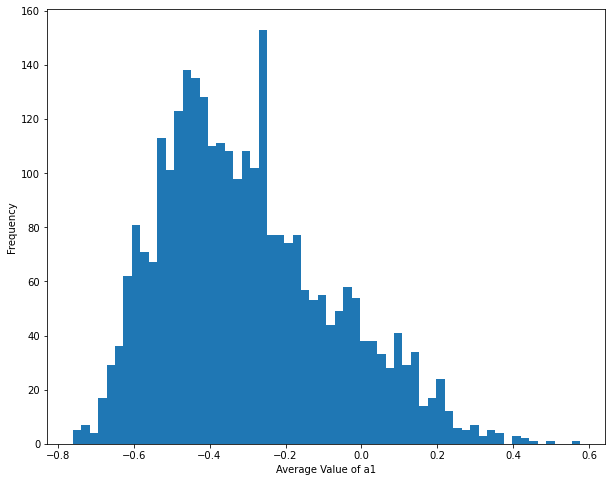

Volatility of Avg_observe: 0.2241722522875153
Minimum: -0.7603229999999996 Maximum: 0.575242
Average: -0.2998347708333334
Coefficient of Variation: 0.7476526210234771


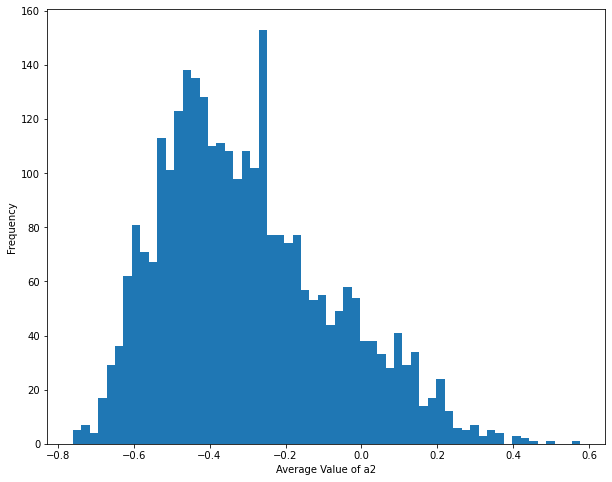

Volatility of Avg_observe: 0.2241722522875153
Minimum: -0.7603229999999996 Maximum: 0.575242
Average: -0.2998347708333334
Coefficient of Variation: 0.7476526210234771


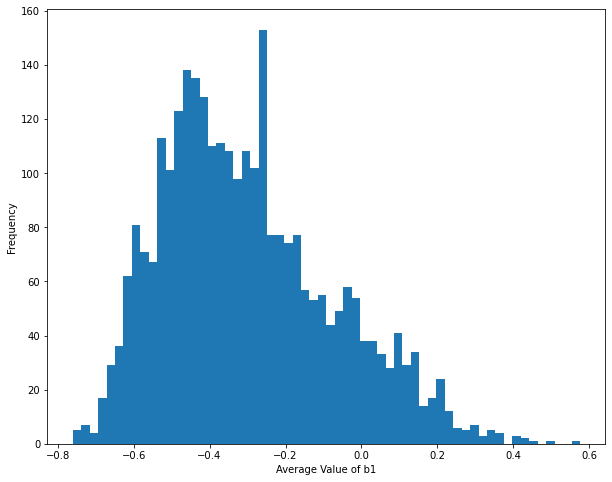

Volatility of Avg_observe: 0.2241722522875153
Minimum: -0.7603229999999996 Maximum: 0.575242
Average: -0.2998347708333334
Coefficient of Variation: 0.7476526210234771


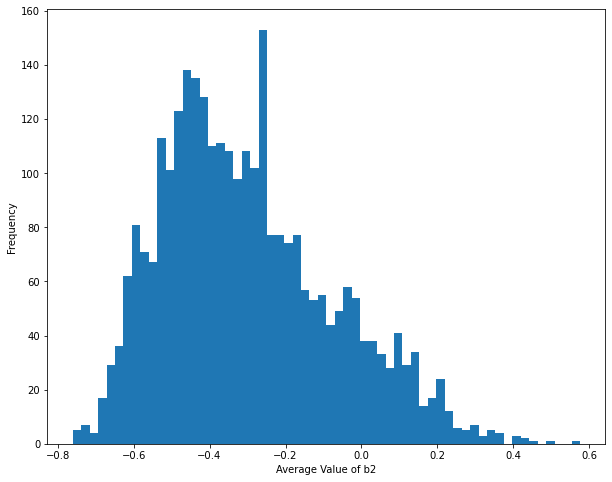

Volatility of Avg_observe: 0.2241722522875153
Minimum: -0.7603229999999996 Maximum: 0.575242
Average: -0.2998347708333334
Coefficient of Variation: 0.7476526210234771


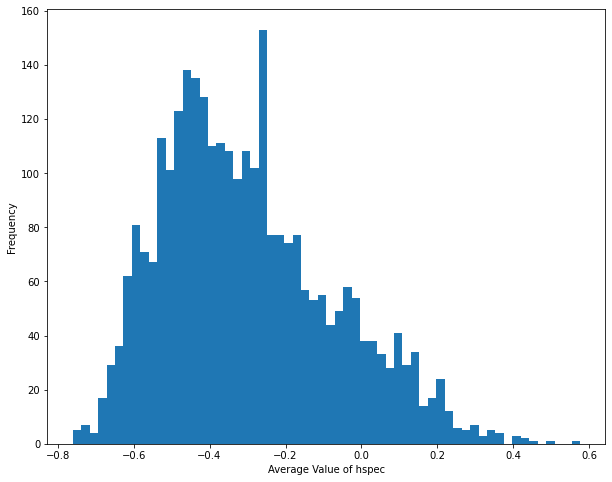

Volatility of Avg_observe: 0.2241722522875153
Minimum: -0.7603229999999996 Maximum: 0.575242
Average: -0.2998347708333334
Coefficient of Variation: 0.7476526210234771


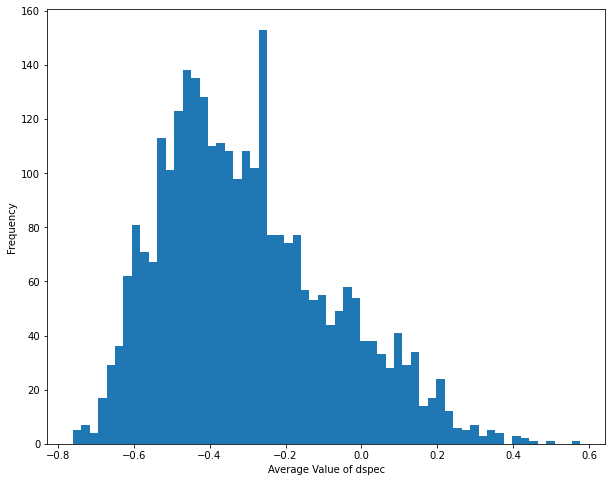

Volatility of Avg_observe: 0.2241722522875153
Minimum: -0.7603229999999996 Maximum: 0.575242
Average: -0.2998347708333334
Coefficient of Variation: 0.7476526210234771


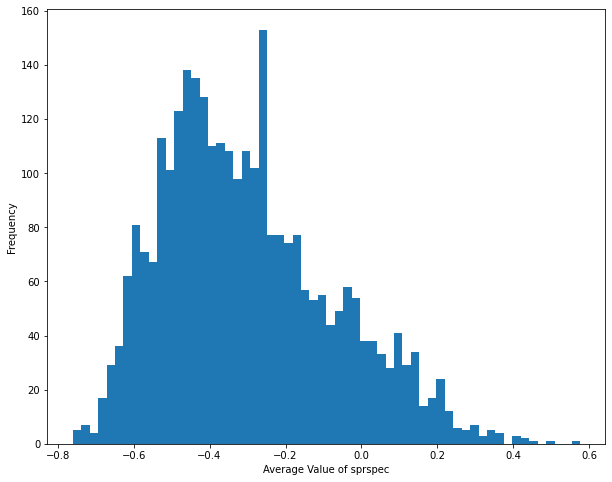

None


In [2]:

def plot_distribution(dataframe):
    for i in range(1, 701,100):
        # Load the time series data into a pandas DataFrame
        df1 = dataframe.iloc[:,i:i+100]
        df1["observe_time"] = dataframe["observe_time"]
        df1["mean_value"] = df.iloc[:, 1:100].sum(axis = 1)/100
        # Calculate the volatility
        volatility = df1['mean_value'].std()
        print("Volatility of Avg_{}:".format(df.columns[0].split("_")[0]), volatility)

        # Find the minimum and maximum values
        minimum = df1['mean_value'].min()
        maximum = df1['mean_value'].max()
        print("Minimum:", minimum, "Maximum:", maximum)

        # Calculate the average value
        average = df1['mean_value'].mean()
        print("Average:", average)
        
        # Calculate the coefficient of variation
        cv = df1['mean_value'].std()/df1['mean_value'].mean()
        print("Coefficient of Variation:", abs(cv))

      
        
         # Create a histogram of the time series
        fig = plt.figure(figsize=(10, 8))
        plt.hist(df1['mean_value'], bins=60)
        plt.xlabel('Average Value of {}'.format(df1.columns[0].split('_')[0]))
        plt.ylabel('Frequency')
        plt.show()


        
       
        
print(plot_distribution(df))

From the plot we observe that average 'a1' is skewed to the right, indicating that most of the data is concentrated on the lower end of the range, with a long tail extending to the right. Meanwhile, average 'a2' is skewed to the left and bimodal, showing that the data is not symmetric and there are two distinct peaks. Average 'b1' also displays a bimodal distribution and is skewed to the left, similar to average 'a2'. Average 'b2' has a left skew, meaning that the majority of the data is concentrated on the higher end of the range. Average 'sprspec' appears to be relatively normal, with a symmetric distribution and the mean, median, and mode close together. In contrast, both 'hspec' and 'dspec' are skewed to the right, with most of the data concentrated on the lower end of the range.

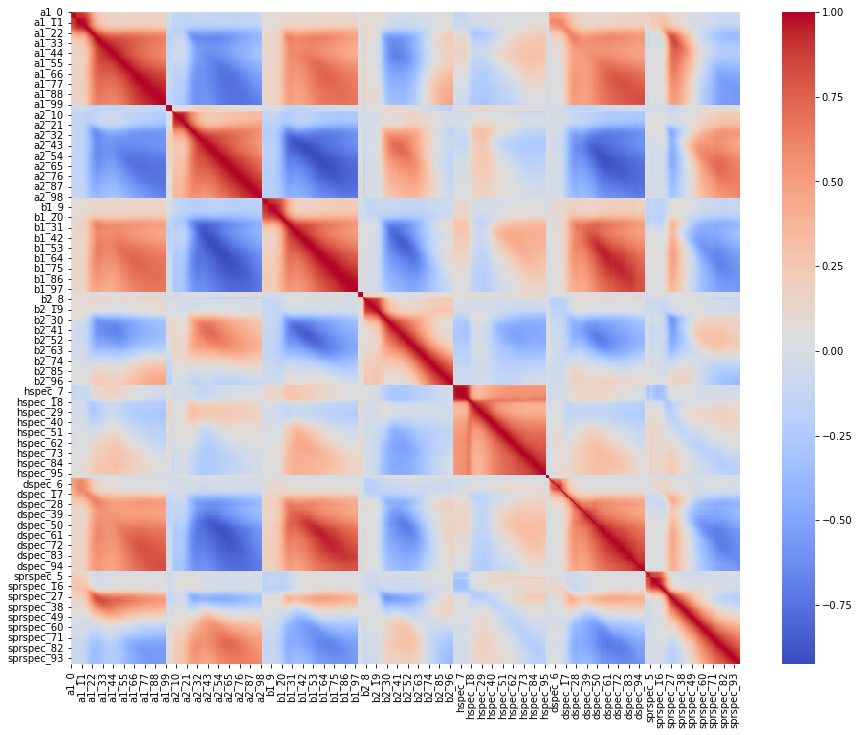

None


In [3]:
def plot_heatmap(dataframe):
    '''This function plots the heatmap for the given dataframe in seaborn'''
    # Visualise the heatmaps
    fig = plt.figure(figsize=(15, 12))
    corr = dataframe.corr()

    # Create the heatmap using the seaborn library
    sns.heatmap(corr, annot=False, cmap='coolwarm')

    # Show the plot
    plt.show()
    
print(plot_heatmap(df))

The heatmap suggests that the variables of type 'a1' have a strong positive correlation among the first few columns (a1_0 to a1_20), but the correlation decreases sharply and then starts increasing again until the last columns (a1_99). The group of variables of type 'a1' also has a weak positive linear relationship with the variable 'dspec', while the group of variables of type 'a2' has a strong negative linear relationship with the variable 'b1'. Other variables do not appear to be correlated. Overall, it seems that there is not a strong linear relationship between the different column types. To further explore these relationships, it may be helpful to visualize the time series data instead of using scatter plots.

In [4]:
import matplotlib.pyplot as plt
import numpy as np
import plotly.express as px
import seaborn as sns
import warnings

def plotTimeSeries_samples(dataframe): 
    '''This funtions plots the timeseries of the first, middle  and last columns for each variable name category'''
    
    # ignore all warnings
    warnings.simplefilter("ignore")
    
    
    new_list = dataframe.columns.to_list()
    
    for i in range(1, 701, 100):
        
        fig = px.line(dataframe,title = "{}, {}, {} Pertime".format(new_list[i].title(),new_list[i+50].title(),new_list[i+99].title()), x = dataframe['observe_time'], y = [new_list[i],new_list[i+50],new_list[i+99]])
        fig = fig.show()

    
print(plotTimeSeries_samples(df))


None


In [5]:
import matplotlib.pyplot as plt
import numpy as np
import plotly.express as px
import seaborn as sns
import warnings

def plotTimeSeries(dataframe): 
    '''This code first converts the 'timestamp' column of the dataframe to datetime format, then sets it as the index. 
    Then it plots a timeseries of the minimum, average and maximum values.
   ''' 
    # ignore all warnings
    warnings.simplefilter("ignore")
    
    lst = dataframe.columns.tolist()[1:]
    
    for i in range(1,701,100):
        dataframe[f"Min_{lst[i][:-2]}"] = dataframe.iloc[:, i:i+100].min(axis = 1)
        dataframe[f"Avg_{lst[i][:-2]}"] = dataframe.iloc[:, i:i+100].sum(axis = 1)/100
        dataframe[f"Max_{lst[i][:-2]}"] = dataframe.iloc[:, i:i+100].max(axis = 1)
        

   

    
    fig = plt.figure(figsize=(8, 5))
    # Calculate the correlation matrix
    

    #sns.heatmap(corr, annot=True)
    new_list = dataframe.columns.tolist()[701:]
    
    for i in range(0, len(new_list), 3):
        fig = px.line(dataframe,title = "{}, {}, {} Pertime".format(new_list[i].title(),new_list[i+1].title(),new_list[i+2].title()), x = dataframe['observe_time'], y = [new_list[i],new_list[i+1],new_list[i+2]])
        fig = fig.show()

    
print(plotTimeSeries(df))


None


<Figure size 576x360 with 0 Axes>

In [6]:

def plot_average_distribution(dataframe):
    for i in range(1, 701,100):
        # Load the time series data into a pandas DataFrame
        df = dataframe.iloc[:,i:i+100]
        
      
        df["mean_value"] = df.sum(axis = 1)/100
        
        # Calculate moving average with window size of 24
        df['moving_average'] = df['mean_value'].rolling(window = 24).mean()

        # Calculate exponential smoothing
        df['exp_smooth']=df['mean_value'].ewm(span = 240).mean()
        
        df["observe_time"] = dataframe["observe_time"]
        # Plot the minimum, mean_value,  moving average, exponential smothing and maximum values
        
        fig = px.line(df,title = "{} : {}, {},{} Pertime".format(df.columns[0].split('_')[0],"Mean", "Moving Averge", "Exp_Smoothing"), x = df['observe_time'], y = ["mean_value", "moving_average", "exp_smooth"])
        
        fig = fig.show()

        
print(plot_average_distribution(df))

None


In [7]:
# The dataframe on hspec shows an unusual peak on 2022-07-30 14:00 reaching a maximum of 356.13281. This needs further investigation
df_2022_07.loc[:, df_2022_07.columns.str.startswith('hspec')][df_2022_07.loc[:, df_2022_07.columns.str.startswith('hspec')].max(axis=1) == 356.13281]

,hspec_0,hspec_1,hspec_2,hspec_3,hspec_4,hspec_5,hspec_6,hspec_7,hspec_8,hspec_9,...,hspec_90,hspec_91,hspec_92,hspec_93,hspec_94,hspec_95,hspec_96,hspec_97,hspec_98,hspec_99
710,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.00061,0.00061,0.00061,0.00061,0.00061,0.00061,0.00061,356.13281,344.88281,325.89844


The sample of time series plots indicates that the volatility, or the degree of fluctuation, varies among the different series. a1_0 and b1_0 have less volatility compared to a1_99 and b1_99, which are highly volatile. The series a2_0, a2_50, a2_99, b2_0, b2_50, b2_99, and dspec_0, dspec_50, dspec_99 are also highly volatile. hspec_50 is also highly volatile, while hspec_0 is less so. Additionally, the volatility of sprspec gradually increases from index 0 to 99.

'a1_0' is relatively constant throughout the period while 'a1_50' and 'a1_99' has upwards trend whereas 'a2_0', 'a2_50' and 'a2_99' has a downward trend and 'hspec_99' has a sharp peak at the end of the month of July